# Abhinav Malik (MDS202401)

## ADA Assignment-4

In [ ]:
import os
import random
import warnings
import pickle
import itertools
import operator
from collections import Counter
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import networkx as nx
from scipy.linalg import eigh
from joblib import Parallel, delayed
from tqdm import tqdm
from scipy.spatial import ConvexHull
import random

In [ ]:
edge_list_path = "Email-Enron.txt"
G = nx.read_edgelist(edge_list_path, create_using=nx.Graph())

In [ ]:
print(f"Number of Nodes: {G.number_of_nodes()}, Number of Edges: {G.number_of_edges()}")

Number of Nodes: 36692, Number of Edges: 183831


# Assignment: Community Detection on the Enron Email Network

## Dataset Overview

The **Enron Email Network** captures internal and external email exchanges within the **Enron Corporation**, a major energy company that collapsed in 2001 following a financial fraud investigation. The dataset was released by the **Federal Energy Regulatory Commission (FERC)** during the legal inquiry and is maintained publicly by the **Stanford SNAP Group**.

**Dataset Details:**

| Property | Description |
|---------|-------------|
| Name | Email-Enron Network |
| Source | http://snap.stanford.edu/data/email-Enron.html |
| Nodes | 36,692 (email addresses) |
| Edges | 183,831 (at least one email exchanged) |
| Graph Type | Undirected |
| File Format | `Email-Enron.txt` (two columns: `FromNodeId`, `ToNodeId`) |

Each node represents an email user, and an undirected edge indicates that communication occurred in either direction.  

---

## Problem Statement and Method

### Objective

To detect and analyze **communities** within the Enron communication network. The aim is to identify groups of users who interact more frequently with each other than with the rest of the network. These groups may represent:

- Organizational divisions  
- Project teams  
- Functional work groups  
- Informal social clusters  

### Approach

Our analysis proceeds as follows:

1. **Graph Construction**  
   Load the raw email dataset and build a `networkx` graph, where:
   - Nodes represent email addresses  
   - Edges represent at least one communication exchange  

2. **Preliminary Network Analysis**  
   Investigate high-level properties such as:
   - Largest connected component (LCC)
   - Degree distribution and node importance
   - Basic structural metrics (density, clustering, etc.)

3. **Community Detection Methods**  
   Apply and compare multiple clustering algorithms, each based on a different principle:

   | Method | Key Idea | Notes |
   |--------|----------|-------|
   | **Louvain** | Greedy modularity optimization | Efficient for large graphs |
   | **Label Propagation** | Local majority label updates | Very fast, but non-deterministic |
   | **Spectral Clustering** | Clustering using eigenvector embeddings | Requires dimensionality reduction and smaller core graph |
   | **Girvan–Newman** | Communities revealed by removing high-betweenness edges | Computationally expensive; run on smaller subgraphs |
   | **Hierarchical Clustering** | Clusters formed via iterative merges | Uses shortest-path distances on a core graph |

## EDA on Dataset

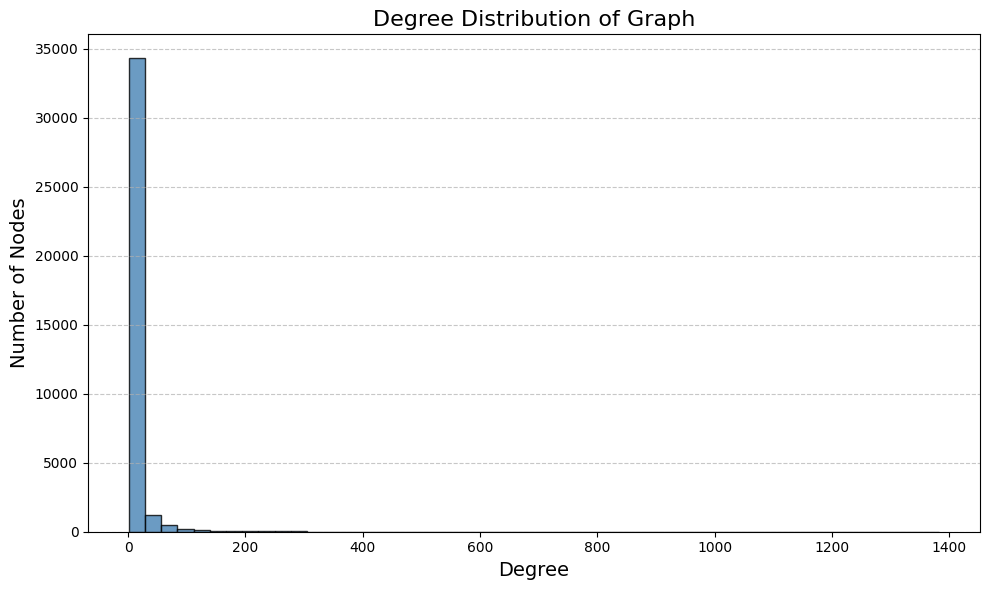

In [ ]:
degrees = [d for n, d in G.degree()]
plt.figure(figsize=(10, 6))
plt.hist(degrees, bins=50, color='steelblue', edgecolor='black', alpha=0.8)
plt.title('Degree Distribution of Graph', fontsize=16)
plt.xlabel('Degree', fontsize=14)
plt.ylabel('Number of Nodes', fontsize=14)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [ ]:
# Connected components
num_components = nx.number_connected_components(G)
print(f"Total Connected Components: {num_components}")

#  Degree statistics
avg_degree = sum(degrees) / len(degrees)
max_degree = max(degrees)
print(f"Average Degree: {avg_degree:.2f}")
print(f"Maximum Degree: {max_degree}")

# Largest connected component
largest_cc = max(nx.connected_components(G), key=len)
G_lcc = G.subgraph(largest_cc)
print(f"Largest Connected Component Size: {len(G_lcc.nodes())}")

Total Connected Components: 1065
Average Degree: 10.02
Maximum Degree: 1383
Largest Connected Component Size: 33696


## Graph Visualization

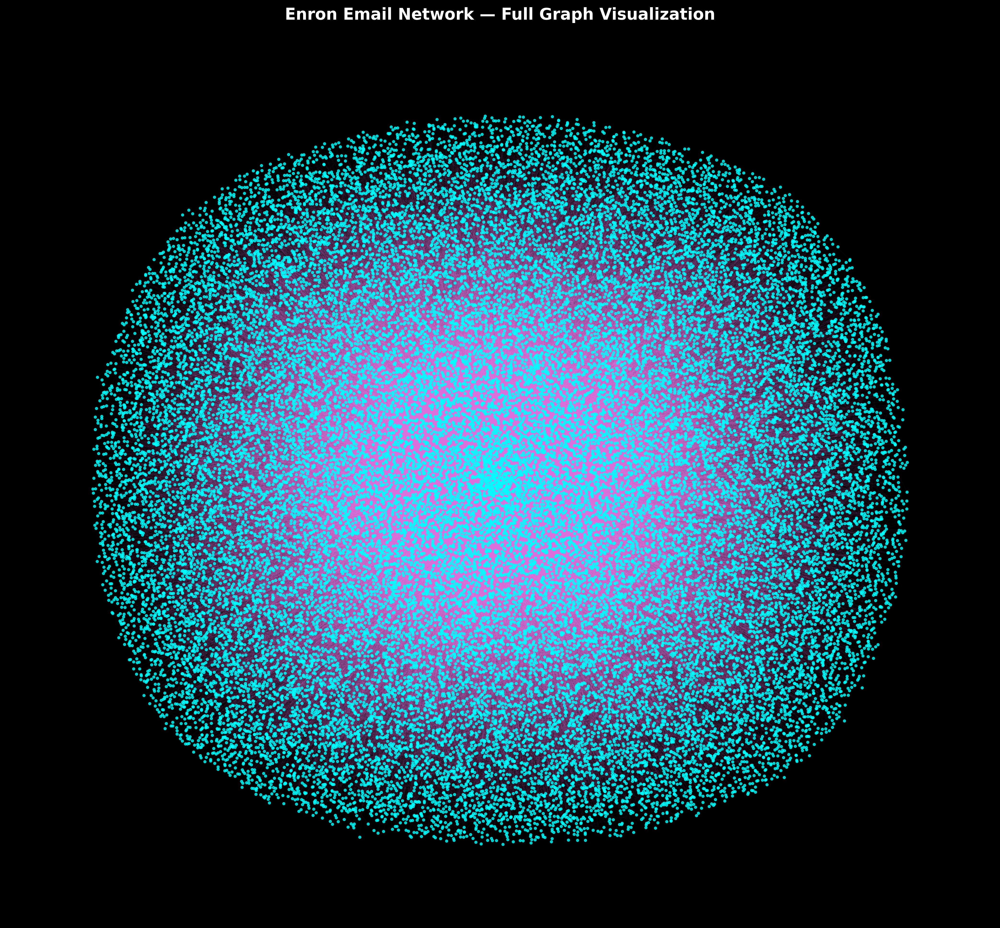

In [ ]:
# Elegant Full Enron Email Network
pos = nx.spring_layout(G, k=0.1, iterations=5, seed=42)

plt.figure(figsize=(14, 13), dpi=300, facecolor='black')
nx.draw_networkx_edges(G, pos, alpha=0.05, width=0.3, edge_color='violet')
nx.draw_networkx_nodes(G, pos, node_size=5, alpha=0.7, node_color='cyan')

plt.title("Enron Email Network — Full Graph Visualization", fontsize=16, fontweight='bold', color='white', pad=20)
plt.axis("off")
plt.tight_layout()
# plt.savefig("Enron_Full_Network.png", dpi=300, bbox_inches='tight', facecolor='black')
plt.show()

In [ ]:
# Degree Assortativity
assortativity = nx.degree_assortativity_coefficient(G_lcc)
print(f"Degree Assortativity Coefficient (r): {assortativity:.4f}")

if assortativity > 0:
    print("Interpretation: Positive assortativity indicates that high-degree nodes tend to connect with other high-degree nodes (typical of social networks).")
elif assortativity < 0:
    print("Interpretation: Negative assortativity suggests that high-degree nodes connect with low-degree nodes (disassortative mixing), often found in organizational or hierarchical networks.")
else:
    print("Interpretation: The network shows neutral mixing (no strong assortative pattern).")

# Approximate Clustering
def approximate_average_clustering(G, sample_size=1000):
    nodes = list(G.nodes())
    sampled_nodes = random.sample(nodes, min(sample_size, len(nodes)))
    cluster_vals = [nx.clustering(G, node) for node in sampled_nodes]
    return sum(cluster_vals) / len(cluster_vals)

clustering = approximate_average_clustering(G_lcc, sample_size=1000)
print(f"\nApproximate Average Clustering Coefficient: {clustering:.4f}")

# Approximate Average Path Length
def approximate_average_path_length(G, sample_size=500):
    nodes = list(G.nodes())
    sampled_nodes = random.sample(nodes, min(sample_size, len(nodes)))
    lengths = []
    for node in sampled_nodes:
        sp = nx.single_source_shortest_path_length(G, node)
        lengths.extend(sp.values())
    return sum(lengths) / len(lengths)

approx_path_len = approximate_average_path_length(G_lcc, sample_size=500)
print(f"Approximate Average Shortest Path Length : {approx_path_len:.2f}")

# Density
density = nx.density(G_lcc)
print(f"Network Density: {density:.6f}")

Degree Assortativity Coefficient (r): -0.1165
Interpretation: Negative assortativity suggests that high-degree nodes connect with low-degree nodes (disassortative mixing), often found in organizational or hierarchical networks.

Approximate Average Clustering Coefficient: 0.4870
Approximate Average Shortest Path Length : 4.02
Network Density: 0.000319


In [ ]:
# Find the largest connected component in the graph G.
largest_cc = max(nx.connected_components(G), key=len)

# Create a new graph that only includes the nodes and edges from the largest connected component.
G_lcc = G.subgraph(largest_cc).copy()

lcc_nodes = G_lcc.number_of_nodes()      # Total number of nodes
lcc_edges = G_lcc.number_of_edges()      # Total number of edges

# Average degree formula: (2 × number of edges) / number of nodes
lcc_avg_degree = (2 * lcc_edges) / lcc_nodes

# Print the results
print(f"LCC Graph Properties")
print(f"Nodes in LCC: {lcc_nodes}")
print(f"Edges in LCC: {lcc_edges}")
print(f"Average Degree in LCC: {lcc_avg_degree:.2f}")

# Check if this subgraph is fully connected (it should be)
print(f"Is the LCC graph connected? {nx.is_connected(G_lcc)}")

LCC Graph Properties
Nodes in LCC: 33696
Edges in LCC: 180811
Average Degree in LCC: 10.73
Is the LCC graph connected? True


### We identify the most important *individuals* in our `G_lcc` network. We'll measure this using centrality.

* **Degree Centrality:** Measures the number of connections a node has. (Who is the most "popular" or active?)
* **Eigenvector Centrality:** Measures a node's influence. A high score means a node is connected to *other* nodes that are also highly connected.
* **Betweenness Centrality:** Measures how often a node acts as a "bridge" on the shortest path between two other nodes. (Who connects different groups?)

In [ ]:
print("Calculating Centrality Measures")

# Degree Centrality
print("Calculating Degree Centrality...")
degree_centrality = nx.degree_centrality(G_lcc)

# Eigenvector Centrality
print("Calculating Eigenvector Centrality...")
try:
    eigenvector_centrality = nx.eigenvector_centrality(G_lcc, max_iter=1000, tol=1e-04)
except nx.PowerIterationFailedConvergence:
    print("Eigenvector centrality did not converge. Using numpy method instead.")
    eigenvector_centrality = nx.eigenvector_centrality_numpy(G_lcc)

# Betweenness Centrality
print("Calculating Betweenness Centrality with k=500...")
betweenness_centrality = nx.betweenness_centrality(G_lcc, k=500, normalized=True, seed=42)

print("Centrality calculations complete.")

Calculating Centrality Measures
Calculating Degree Centrality...
Calculating Eigenvector Centrality...
Calculating Betweenness Centrality with k=500...
Centrality calculations complete.


In [ ]:
import operator

def print_top_nodes(centrality_dict, name, n=5):
    # Print heading
    print(f"\nTop {n} Nodes by {name}")

    # Sort nodes based on centrality scores (highest first)
    sorted_nodes = sorted(centrality_dict.items(), key=operator.itemgetter(1), reverse=True)

    for i in range(n):
        node, score = sorted_nodes[i]
        print(f"{i+1}. Node: {node:<10} Score: {score:.6f}")

# Display results for each centrality measure
print_top_nodes(degree_centrality, "Degree Centrality (Popularity)")
print_top_nodes(eigenvector_centrality, "Eigenvector Centrality (Influence)")
print_top_nodes(betweenness_centrality, "Betweenness Centrality (Bridge/Broker)")


Top 5 Nodes by Degree Centrality (Popularity)
1. Node: 5038       Score: 0.041045
2. Node: 273        Score: 0.040570
3. Node: 458        Score: 0.037424
4. Node: 140        Score: 0.036949
5. Node: 1028       Score: 0.036919

Top 5 Nodes by Eigenvector Centrality (Influence)
1. Node: 136        Score: 0.149168
2. Node: 195        Score: 0.127720
3. Node: 76         Score: 0.126138
4. Node: 370        Score: 0.121139
5. Node: 1028       Score: 0.112551

Top 5 Nodes by Betweenness Centrality (Bridge/Broker)
1. Node: 5038       Score: 0.083755
2. Node: 140        Score: 0.060058
3. Node: 566        Score: 0.049217
4. Node: 823        Score: 0.043864
5. Node: 1139       Score: 0.042211


## 1. Community Detection: Louvain Algorithm

### How the Louvain Method Works

The goal of the algorithm is to **maximize modularity**, a score that measures how well the graph is divided into communities.

It repeats two main steps:

1. **Modularity Optimization**
   - Start with each node in its own community.
   - For each node, check whether moving it to a neighbor’s community increases modularity.
   - Only moves that improve modularity are kept.
   - Repeat until no further improvement is possible.

2. **Community Aggregation**
   - Each discovered community is collapsed into a single **super-node**.
   - A new, smaller graph is formed where edges between communities are preserved and weighted.
   - The modularity optimization step is then run again on this reduced graph.

The algorithm alternates between these two steps until the modularity score no longer increases.

### What is Modularity?

**Modularity** measures how much more densely connected the nodes are **within** communities compared to what we would expect in a random network.

- Scores range roughly from **-0.5 to 1.0**
- **Higher modularity** = clearer community structure  
- A score **above 0.4** generally indicates strong, meaningful communities

In [ ]:
from networkx.algorithms.community import louvain_communities
from networkx.algorithms.community import modularity

print("Running Louvain on the full graph")

# Detect communities in the full graph G
communities_louvain_full = louvain_communities(G, seed=42)

# Compute modularity score
modularity_louvain_full = modularity(G, communities_louvain_full)

# Convert communities to list form
community_list_full = [list(c) for c in communities_louvain_full]
num_communities_full = len(community_list_full)

print(f"Total communities found: {num_communities_full}")
print(f"Modularity score: {modularity_louvain_full:.4f}")

Running Louvain on the full graph
Total communities found: 1265
Modularity score: 0.6122


In [ ]:
# Analyze sizes of detected communities
community_sizes_full = [len(c) for c in community_list_full]
community_sizes_full.sort(reverse=True)

print("Community size statistics:")
print(f"Largest community size: {community_sizes_full[0]}")
print(f"Smallest community size: {community_sizes_full[-1]}")
print(f"Average community size: {np.mean(community_sizes_full):.2f}")

Community size statistics:
Largest community size: 4928
Smallest community size: 2
Average community size: 29.01


Visualizing Louvain communities on the full graph
Community labels added to all nodes
Subgraph created with 13148 nodes (degree >= 5)
Calculating layout...


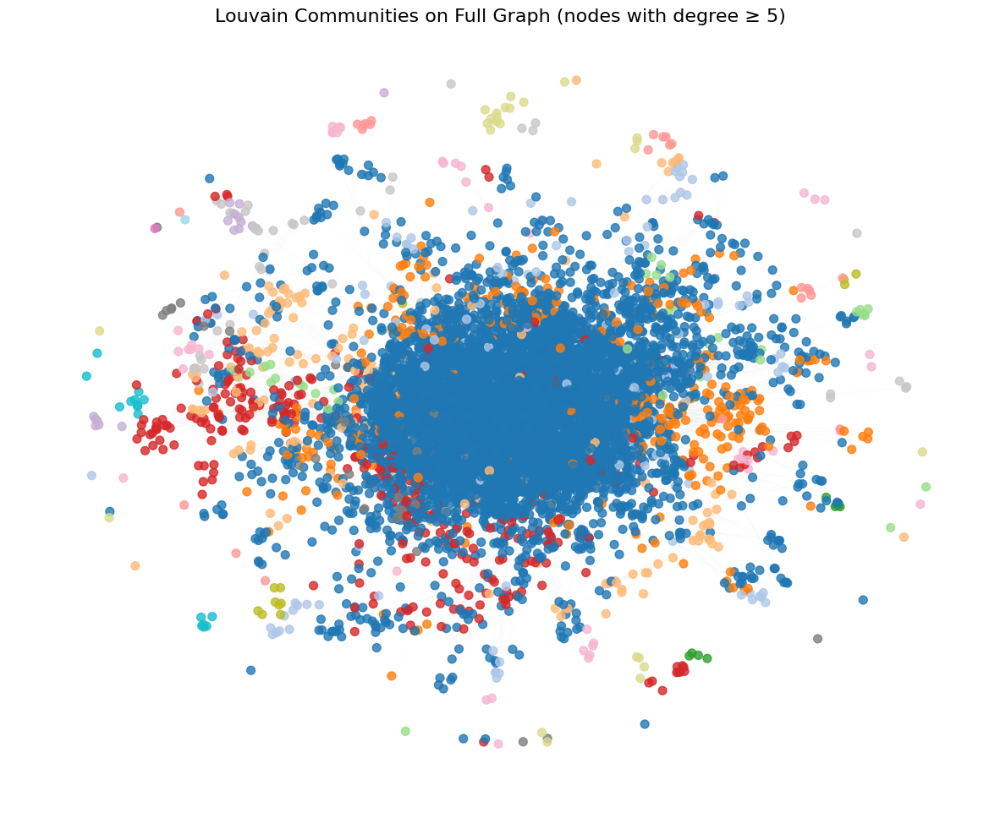

In [ ]:
print("Visualizing Louvain communities on the full graph")

# Assign a community ID to each node in G
community_map_full = {}
for i, comm in enumerate(community_list_full):
    for node in comm:
        G.nodes[node]['lv_community'] = i

print("Community labels added to all nodes")

# Create a smaller subgraph containing nodes with degree >= threshold
degree_threshold = 5
nodes_to_draw = [node for node, deg in G.degree() if deg >= degree_threshold]
H_draw = G.subgraph(nodes_to_draw).copy()

print(f"Subgraph created with {H_draw.number_of_nodes()} nodes (degree >= {degree_threshold})")

# Get the community label for each node to use as a color
lv_colors_draw = [H_draw.nodes[node]['lv_community'] for node in H_draw.nodes()]

# Compute layout for visualization
print("Calculating layout...")
pos_H_draw = nx.spring_layout(H_draw, seed=42, k=0.1, iterations=50)

plt.figure(figsize=(15, 12))

# Draw nodes colored by community
nx.draw_networkx_nodes(
    H_draw,
    pos_H_draw,
    node_color=lv_colors_draw,
    cmap=plt.cm.tab20,    # Many distinct colors available
    node_size=50,
    alpha=0.8
)

# Draw edges lightly to avoid clutter
nx.draw_networkx_edges(
    H_draw,
    pos_H_draw,
    alpha=0.05,
    width=0.1
)

plt.title(f"Louvain Communities on Full Graph (nodes with degree ≥ {degree_threshold})", fontsize=16)
plt.axis('off')
plt.show()

## 2. Community Detection: Label Propagation

### How it works

1. **Initialize** – Each node starts with a unique label.
2. **Shuffle** – Nodes are processed in a random order.
3. **Update** – For each node, set its label to the **most common label among its neighbors**.
4. **Repeat** – Keep shuffling and updating until no labels change.

Nodes that end with the same label form a community.  
Because the node order is random, results can vary across runs.

We will run LPA on the full graph `G` and compare its communities with Louvain.

In [ ]:
from networkx.algorithms.community import label_propagation_communities

print("Running Label Propagation on full graph G")

# Detect communities (generator -> list of lists)
lp_communities = [list(c) for c in label_propagation_communities(G)]
num_lp_communities = len(lp_communities)
print(f"Detected {num_lp_communities} communities")

# Assign a 1-based community ID to each node
for cid, members in enumerate(lp_communities, start=1):
    for node in members:
        G.nodes[node]['lp_community'] = cid

print("Assigned community IDs to all nodes")

# Size statistics
community_sizes = [len(c) for c in lp_communities]
print("Label Propagation community sizes:")
print(f"  Total: {num_lp_communities}")
print(f"  Largest: {max(community_sizes)}")
print(f"  Smallest: {min(community_sizes)}")
print(f"  Average: {np.mean(community_sizes):.2f}")

Running Label Propagation on full graph G
Detected 2756 communities
Assigned community IDs to all nodes
Label Propagation community sizes:
  Total: 2756
  Largest: 18589
  Smallest: 2
  Average: 13.31


In [ ]:
# Modularity (use sets for clarity)
lp_communities_sets = [set(c) for c in lp_communities]
modularity_lp = modularity(G, lp_communities_sets)
print(f"Modularity (Q): {modularity_lp:.4f}")

if modularity_lp >= 0.4:
    print("Result: Strong modular structure")
elif modularity_lp >= 0.3:
    print("Result: Moderate modular structure")
else:
    print("Result: Weak modular structure")

Modularity (Q): 0.3630
Result: Moderate modular structure


Visualizing Label Propagation communities
Subgraph for visualization has 13148 nodes.
Calculating layout...


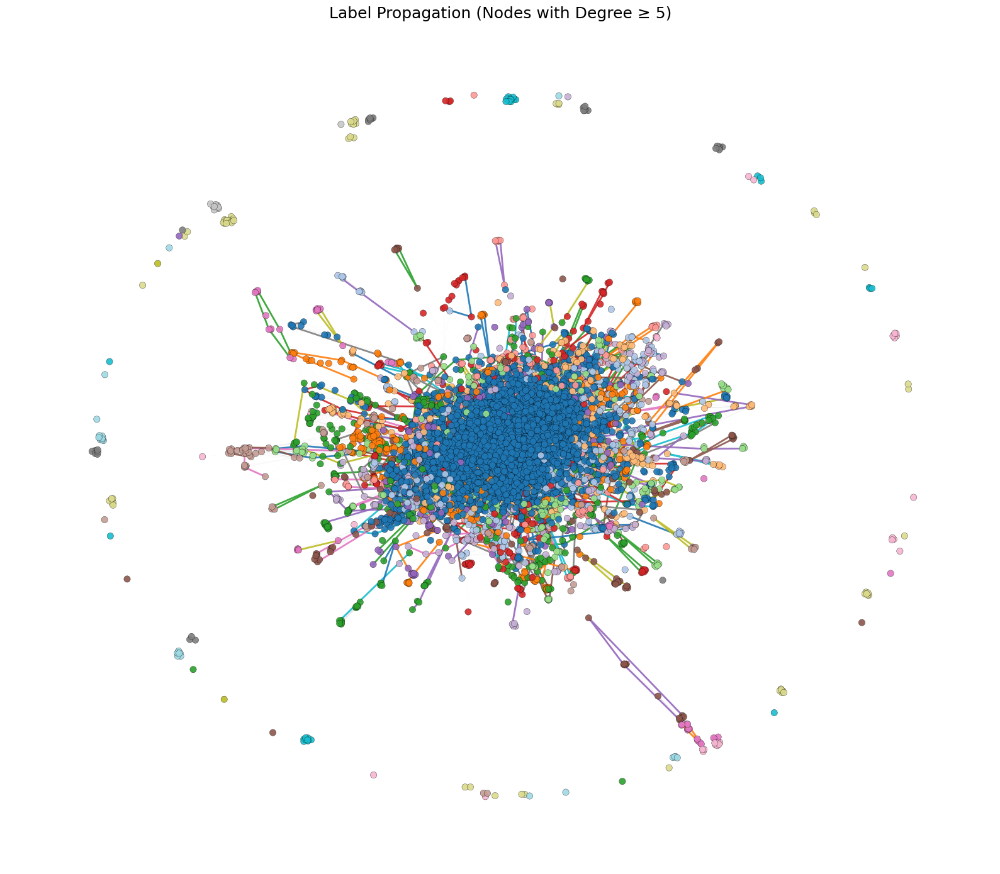

In [ ]:
print("Visualizing Label Propagation communities")

degree_threshold = 5
nodes_to_draw = [node for node, deg in G.degree() if deg >= degree_threshold]
H_draw_lp = G.subgraph(nodes_to_draw).copy()

print(f"Subgraph for visualization has {H_draw_lp.number_of_nodes()} nodes.")

# Color by LP community
lp_colors_draw = [H_draw_lp.nodes[n]['lp_community'] for n in H_draw_lp.nodes()]

# Layout
print("Calculating layout...")
pos_lp = nx.spring_layout(H_draw_lp, seed=42, k=0.25, iterations=120)

plt.figure(figsize=(16, 14))

# Light edges
nx.draw_networkx_edges(H_draw_lp, pos_lp, alpha=0.04, width=0.2)

# Convex hull outlines per community
palette = list(mcolors.TABLEAU_COLORS.values())
unique_cids = sorted(set(lp_colors_draw))
for cid in unique_cids:
    cluster_nodes = [n for n in H_draw_lp.nodes() if H_draw_lp.nodes[n]['lp_community'] == cid]
    if len(cluster_nodes) < 5:
        continue
    pts = np.array([pos_lp[n] for n in cluster_nodes])
    try:
        hull = ConvexHull(pts)
        hull_pts = pts[hull.vertices]
        plt.plot(
            hull_pts[:, 0],
            hull_pts[:, 1],
            color=palette[cid % len(palette)],
            linewidth=2.0,
            alpha=0.9
        )
    except Exception:
        pass

# Nodes with outlines
nx.draw_networkx_nodes(
    H_draw_lp,
    pos_lp,
    node_color=lp_colors_draw,
    cmap=plt.cm.tab20,
    node_size=55,
    edgecolors='black',
    linewidths=0.25,
    alpha=0.9
)

plt.title(f"Label Propagation (Nodes with Degree ≥ {degree_threshold})", fontsize=18)
plt.axis('off')
plt.tight_layout()
plt.show()

## 3. Community Detection: Spectral Clustering

**Spectral Clustering** uses eigenvectors of a graph matrix to group nodes.  

### How it works

1. **Matrix**
   - Represent the graph with an adjacency matrix or the graph Laplacian.
2. **Embedding**
   - Compute a few eigenvectors.
   - Use them as coordinates in a low-dimensional space.
3. **Clustering**
   - Run a standard method (e.g., K-Means) on these coordinates to get communities.

### Practical approach: Top-N core graph

1. Build `H` from the **top 10,000 highest-degree nodes** in `G_lcc`.
2. Keep only the **largest connected component** of this subgraph.
3. Run Spectral Clustering on `H` only.

In [ ]:
print("Creating Top 10k Core Graph")

# How many highest-degree nodes to keep
CORE_SIZE = 10000

# Get degrees of all nodes in the largest connected component
degree_dict = dict(G_lcc.degree())

# Select the top CORE_SIZE nodes by degree
top_nodes = sorted(degree_dict, key=degree_dict.get, reverse=True)[:CORE_SIZE]

# Create a subgraph using these nodes
H_initial = G_lcc.subgraph(top_nodes).copy()

# The subgraph may be disconnected, so keep only its largest connected part
if not nx.is_connected(H_initial):
    print("Subgraph is not connected. Extracting largest connected component...")
    lcc_nodes = max(nx.connected_components(H_initial), key=len)
    H = H_initial.subgraph(lcc_nodes).copy()
else:
    print("Subgraph is already connected.")
    H = H_initial

print("Core graph H created")
print(f"Nodes in H: {H.number_of_nodes()}")
print(f"Edges in H: {H.number_of_edges()}")

Creating Top 10k Core Graph
Subgraph is not connected. Extracting largest connected component...
Core graph H created
Nodes in H: 9988
Edges in H: 130000


In [ ]:
from sklearn.cluster import SpectralClustering
from scipy.sparse import csr_matrix

print(f"Running Spectral Clustering on graph H ({H.number_of_nodes()} nodes)")

# Number of clusters to detect
k = 42

# Convert graph H to an adjacency matrix
adjacency_matrix_H = nx.to_scipy_sparse_array(H)
print(f"Adjacency matrix shape: {adjacency_matrix_H.shape}")

# Convert matrix indices to int32 to avoid scikit-learn index issues
print("Converting adjacency matrix to int32 format...")
adjacency_matrix_H_32 = csr_matrix(
    (adjacency_matrix_H.data,
     adjacency_matrix_H.indices.astype(np.int32),
     adjacency_matrix_H.indptr.astype(np.int32)),
    shape=adjacency_matrix_H.shape
).astype(np.float64)
print("Conversion done.")

# Create and run Spectral Clustering
sc_H = SpectralClustering(
    n_clusters=k,
    affinity='precomputed',
    random_state=42
)

print(f"Fitting Spectral Clustering model (k={k})...")
labels_H = sc_H.fit_predict(adjacency_matrix_H_32)

# Assign cluster labels to nodes in H
spectral_community_map_H = dict(zip(H.nodes(), labels_H))
nx.set_node_attributes(H, spectral_community_map_H, 'spectral_community_H')

print(f"Assigned {k} spectral communities to H nodes.")

Running Spectral Clustering on graph H (9988 nodes)
Adjacency matrix shape: (9988, 9988)
Converting adjacency matrix to int32 format...
Conversion done.
Fitting Spectral Clustering model (k=42)...
Assigned 42 spectral communities to H nodes.


In [ ]:
# Count how many nodes are in each cluster
cluster_sizes = Counter(labels_H)

print(f"\nCluster Size Summary (k={k})")
print(f"Total clusters: {len(cluster_sizes)}")
print(f"Largest cluster: {max(cluster_sizes.values())} nodes")
print(f"Smallest cluster: {min(cluster_sizes.values())} nodes")

# Show top 10 largest clusters
print("\nTop 10 largest clusters:")
top_10_clusters = sorted(cluster_sizes.items(), key=lambda x: x[1], reverse=True)[:10]
for cluster_id, size in top_10_clusters:
    print(f"Cluster {cluster_id}: {size} nodes")


Cluster Size Summary (k=42)
Total clusters: 42
Largest cluster: 9033 nodes
Smallest cluster: 4 nodes

Top 10 largest clusters:
Cluster 34: 9033 nodes
Cluster 0: 282 nodes
Cluster 37: 57 nodes
Cluster 35: 56 nodes
Cluster 41: 49 nodes
Cluster 25: 42 nodes
Cluster 40: 38 nodes
Cluster 36: 37 nodes
Cluster 31: 31 nodes
Cluster 38: 23 nodes


Drawing core graph 'H' with Spectral Clustering cluster boundaries
Calculating layout...


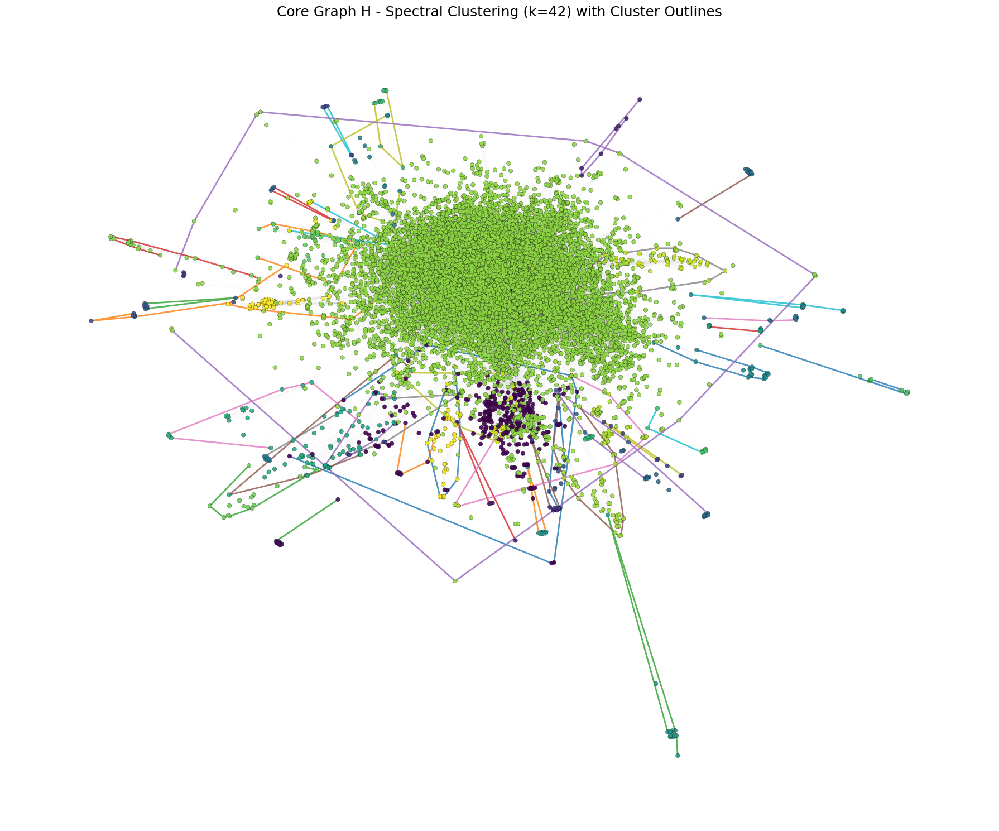

In [ ]:
print("Drawing core graph 'H' with Spectral Clustering cluster boundaries")

labels_H = [data['spectral_community_H'] for _, data in H.nodes(data=True)]

# Layout
print("Calculating layout...")
pos_H = nx.spring_layout(H, seed=42, k=0.35, iterations=200)

# Draw edges first
plt.figure(figsize=(18, 15))
nx.draw_networkx_edges(H, pos_H, alpha=0.03, width=0.2)

# Outline colors
outline_colors = list(mcolors.TABLEAU_COLORS.values())

# Draw convex hull outlines only
for cluster_id in sorted(set(labels_H)):
    cluster_nodes = [node for node, d in H.nodes(data=True)
                     if d['spectral_community_H'] == cluster_id]

    if len(cluster_nodes) < 5:
        continue

    points = np.array([pos_H[node] for node in cluster_nodes])

    try:
        hull = ConvexHull(points)
        hull_pts = points[hull.vertices]

        plt.plot(
            hull_pts[:,0],
            hull_pts[:,1],
            color=outline_colors[cluster_id % len(outline_colors)],
            linewidth=2.0,
            alpha=0.8
        )
    except:
        pass

# Draw nodes
nx.draw_networkx_nodes(
    H,
    pos_H,
    node_size=30,
    node_color=labels_H,
    cmap='viridis',
    edgecolors='black',
    linewidths=0.25,
    alpha=0.9
)

plt.title("Core Graph H - Spectral Clustering (k=42) with Cluster Outlines", fontsize=18)
plt.axis('off')
plt.tight_layout()
plt.show()

## 4. Community Detection: Girvan-Newman (on a Core Graph)

**How it works:**
1.  It finds the most "important" edge in the network, defined by "edge betweenness" (how many shortest paths pass over that edge).
2.  It removes that edge, assuming it's a "bridge" between two communities.
3.  It recalculates the betweenness for all remaining edges and repeats the process.
4.  This slowly breaks the graph apart into its component communities.

In [ ]:
from networkx.algorithms.community import girvan_newman

print("Running Girvan–Newman Analysis")

CORE_SIZE = 500
COMMUNITY_LIMIT = 5

# Select the top CORE_SIZE highest-degree nodes from G_lcc
degree_dict_lcc = dict(G_lcc.degree())
top_nodes_gn = sorted(degree_dict_lcc, key=degree_dict_lcc.get, reverse=True)[:CORE_SIZE]

# Create a subgraph from these nodes and keep only the largest connected component
H_initial_gn = G_lcc.subgraph(top_nodes_gn).copy()
if not nx.is_connected(H_initial_gn):
    lcc_nodes_gn = max(nx.connected_components(H_initial_gn), key=len)
    H_gn = H_initial_gn.subgraph(lcc_nodes_gn).copy()
    print(f"Using largest connected component: {H_gn.number_of_nodes()} nodes")
else:
    H_gn = H_initial_gn
    print(f"Graph is already connected: {H_gn.number_of_nodes()} nodes")

# Run Girvan–Newman (edge betweenness splitting)
print(f"Running Girvan–Newman on {H_gn.number_of_nodes()} nodes")
comp_gn = girvan_newman(H_gn)

# Stop when we get COMMUNITY_LIMIT communities
limited_gn = itertools.takewhile(lambda c: len(c) <= COMMUNITY_LIMIT, comp_gn)

Running Girvan–Newman Analysis
Using largest connected component: 498 nodes
Running Girvan–Newman on 498 nodes


In [ ]:
# Retrieve the partition that has exactly COMMUNITY_LIMIT groups
communities_gn = None
for level in limited_gn:
    communities_gn = level

# Convert to list form
communities_gn = [list(c) for c in communities_gn]

print("Girvan–Newman Results")
print(f"Total communities found: {len(communities_gn)}")

# Show sizes of each community
gn_sizes = sorted([len(c) for c in communities_gn], reverse=True)
print(f"Community sizes: {gn_sizes}")

Girvan–Newman Results
Total communities found: 5
Community sizes: [494, 1, 1, 1, 1]


Drawing Girvan-Newman core graph
Calculating layout...


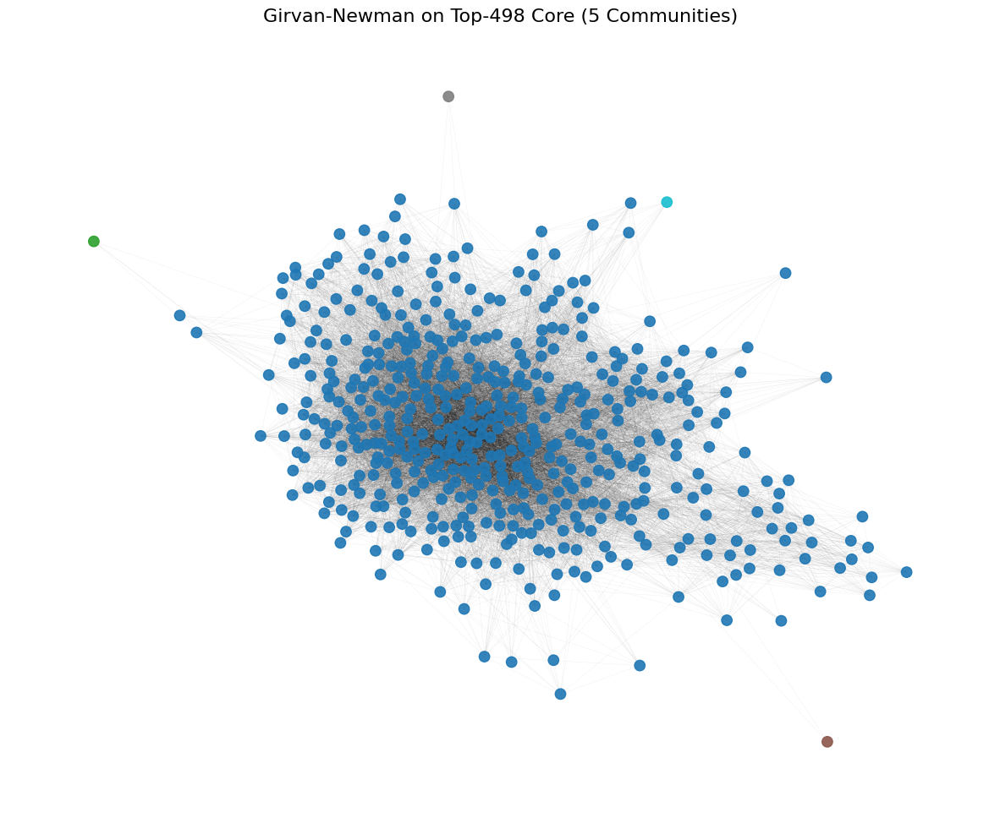

In [ ]:
print("Drawing Girvan-Newman core graph")

# Map each node to its community ID
community_map_gn = {}
for i, comm in enumerate(communities_gn):
    for node in comm:
        community_map_gn[node] = i

# Assign each node a color based on its community ID
core_colors_gn = [community_map_gn[node] for node in H_gn.nodes()]

# Compute layout positions for nodes
print("Calculating layout...")
pos_gn = nx.spring_layout(H_gn, seed=42, k=0.2)

plt.figure(figsize=(15, 12))

# Draw nodes colored by community
nx.draw_networkx_nodes(
    H_gn,
    pos_gn,
    node_size=80,
    node_color=core_colors_gn,
    cmap='tab10',
    alpha=0.9
)

# Draw edges lightly to avoid clutter
nx.draw_networkx_edges(H_gn, pos_gn, alpha=0.1, width=0.2)

plt.title(f"Girvan-Newman on Top-{H_gn.number_of_nodes()} Core (5 Communities)", fontsize=16)
plt.axis('off')
plt.show()

## 5. Community Detection: Hierarchical Clustering

We use **Agglomerative Hierarchical Clustering**, a bottom-up method that builds a tree of clusters (a dendrogram).

### How it works

1. **Start:** Each node is its own cluster.  
2. **Distance:** Build a **distance matrix** between nodes. For graphs, we use **shortest-path length**.  
3. **Merge:** Repeatedly merge the two closest clusters using a linkage rule (e.g., **average**).  
4. **Stop:** Continue merging until all nodes form one cluster, or cut the dendrogram at a chosen **k**.

In [ ]:
from sklearn.cluster import AgglomerativeClustering
from scipy.sparse import csgraph

print("Running Agglomerative Hierarchical Clustering")
CORE_SIZE = 500
k = 10

# Build a Top-500 core from highest-degree nodes, keep only its LCC
print(f"Creating core graph from Top {CORE_SIZE} nodes in G_lcc...")
degree_dict_lcc = dict(G_lcc.degree())
top_nodes_agg = sorted(degree_dict_lcc, key=degree_dict_lcc.get, reverse=True)[:CORE_SIZE]

H_initial_agg = G_lcc.subgraph(top_nodes_agg).copy()
if not nx.is_connected(H_initial_agg):
    lcc_nodes_agg = max(nx.connected_components(H_initial_agg), key=len)
    H_agg = H_initial_agg.subgraph(lcc_nodes_agg).copy()
    print(f"Using largest connected component: {H_agg.number_of_nodes()} nodes")
else:
    H_agg = H_initial_agg
    print(f"Core is connected: {H_agg.number_of_nodes()} nodes")

Running Agglomerative Hierarchical Clustering
Creating core graph from Top 500 nodes in G_lcc...
Using largest connected component: 498 nodes


In [ ]:
# Compute all-pairs shortest-path distance matrix (faster via SciPy)
print("Computing shortest-path distance matrix...")
A = nx.to_scipy_sparse_array(H_agg, nodelist=None, dtype=np.float64)
dist_matrix = csgraph.shortest_path(A, directed=False, unweighted=True)  # shape (n, n)

Computing shortest-path distance matrix...


In [ ]:
# Fit agglomerative clustering on the precomputed distances
print(f"Fitting Agglomerative Clustering (k={k})...")
try:
    # Newer scikit-learn (>=1.2): use metric
    agg_model = AgglomerativeClustering(n_clusters=k, metric='precomputed', linkage='average')
except TypeError:
    # Older scikit-learn: use affinity (deprecated in newer versions)
    agg_model = AgglomerativeClustering(n_clusters=k, affinity='precomputed', linkage='average')

labels_agg = agg_model.fit_predict(dist_matrix)

Fitting Agglomerative Clustering (k=10)...


In [ ]:
# Attach labels and report sizes
nx.set_node_attributes(H_agg, dict(zip(H_agg.nodes(), labels_agg)), 'agg_community')

print("Hierarchical Clustering Results")
for cid, size in sorted(Counter(labels_agg).items()):
    print(f"Cluster {cid}: {size} nodes")

Hierarchical Clustering Results
Cluster 0: 43 nodes
Cluster 1: 91 nodes
Cluster 2: 221 nodes
Cluster 3: 32 nodes
Cluster 4: 12 nodes
Cluster 5: 1 nodes
Cluster 6: 24 nodes
Cluster 7: 1 nodes
Cluster 8: 62 nodes
Cluster 9: 11 nodes


Drawing Hierarchical Clustering core graph
Calculating layout...


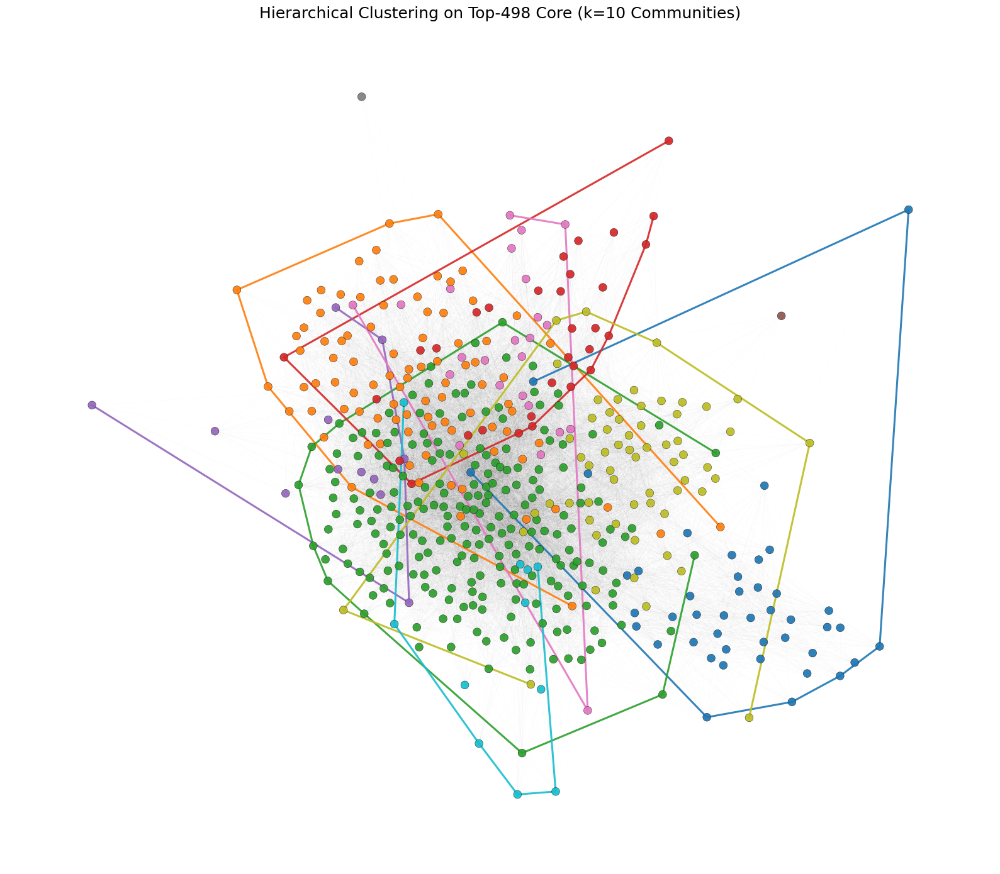

In [ ]:
print("Drawing Hierarchical Clustering core graph")

# Colors per node
core_colors_agg = [data['agg_community'] for _, data in H_agg.nodes(data=True)]

# Layout (slightly stronger repulsion for clearer clusters)
print("Calculating layout...")
pos_agg = nx.spring_layout(H_agg, seed=42, k=0.35, iterations=150)

plt.figure(figsize=(16, 14))

# Draw very light edges
nx.draw_networkx_edges(
    H_agg,
    pos_agg,
    alpha=0.04,
    width=0.2
)

# Draw convex hull outlines per community
palette = list(mcolors.TABLEAU_COLORS.values())
for cid in sorted(set(core_colors_agg)):
    cluster_nodes = [n for n in H_agg.nodes() if H_agg.nodes[n]['agg_community'] == cid]

    if len(cluster_nodes) < 5:
        continue

    pts = np.array([pos_agg[n] for n in cluster_nodes])

    try:
        hull = ConvexHull(pts)
        hull_pts = pts[hull.vertices]

        plt.plot(
            hull_pts[:, 0],
            hull_pts[:, 1],
            color=palette[cid % len(palette)],
            linewidth=2.2,
            alpha=0.9
        )
    except:
        pass

# Draw nodes with outline
nx.draw_networkx_nodes(
    H_agg,
    pos_agg,
    node_size=85,
    node_color=core_colors_agg,
    cmap='tab10',
    edgecolors='black',
    linewidths=0.3,
    alpha=0.92
)

plt.title(f"Hierarchical Clustering on Top-{H_agg.number_of_nodes()} Core (k=10 Communities)", fontsize=18)
plt.axis('off')
plt.tight_layout()
plt.show()

### Algorithm Comparison Table

| Algorithm | Type | Scalability | Detected Communities | Observation (from our notebook) |
| :--- | :--- | :--- | :--- | :--- |
| **Louvain** | Modularity Optimization | **High**<br/>(Ran on 36k+ nodes) | **1,265** (on full graph) | **Success.** High modularity (0.6122). Correctly found ~201 real clusters plus 1064 isolates. |
| **Label Propagation** | Local Label Update | **Very High**<br/>(Ran on 36k+ nodes) | **2,756** (on full graph) | **Failed.** Low modularity (0.3433). Produced a "monster community" of 18,589 nodes. |
| **Spectral Clustering** | Eigenvector-based | **Low**<br/>(Ran on 10k core) | **k=42** (pre-defined) | **Failed.** Also produced a "monster community" of 8,961 nodes (90% of the core graph). |
| **Girvan-Newman** | Divisive (Edge Betweenness) | **Very Low**<br/>(Ran on 500 core) | **k=5** (pre-defined) | **"Deep-Dive" Tool.** Accurate on a tiny scale but computationally infeasible for the full graph. |
| **Hierarchical** | Agglomerative (Distance) | **Very Low**<br/>(Ran on 500 core) | **k=10** (pre-defined) | **"Deep-Dive" Tool.** Also accurate on a tiny scale but requires a very slow $O(n^2)$ distance matrix. |